In [1]:
import numpy as np
import pandas as pd
import lightgbm as lgb
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import f1_score, precision_score, recall_score, accuracy_score
from sklearn.preprocessing import LabelEncoder
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import entropy
import gc
import os
from tqdm import tqdm
from tqdm import tqdm_notebook


In [2]:
data_train  = pd.read_csv('sensor_train.csv')
data_test  = pd.read_csv('sensor_test.csv')

In [5]:
data_train.head(60)

,fragment_id,time_point,acc_x,acc_y,acc_z,acc_xg,acc_yg,acc_zg,behavior_id
0,0,27,0.3,-0.3,0.1,0.6,4.5,8.8,0
1,0,108,0.1,-0.0,-0.4,0.4,4.7,8.4,0
2,0,198,0.1,0.0,0.3,0.9,4.6,9.0,0
3,0,297,0.1,-0.1,-0.5,0.8,4.7,7.2,0
4,0,388,0.1,0.2,0.6,0.9,4.7,8.9,0
5,0,471,-0.2,0.0,0.2,0.6,4.9,8.6,0
6,0,560,0.0,-0.0,0.1,0.6,4.9,8.6,0
7,0,644,0.0,0.0,-0.7,1.3,5.0,8.3,0
8,0,730,0.4,-0.0,-0.2,1.0,5.1,8.3,0
9,0,814,-0.1,-0.0,-0.2,0.6,5.0,8.1,0


In [3]:
data_test['fragment_id'] += 10000
label = 'behavior_id'
data = pd.concat([data_train, data_test], sort=False)
df = data.drop_duplicates(subset=['fragment_id']).reset_index(drop=True)[['fragment_id', 'behavior_id']]

data = data.sort_values(["fragment_id","time_point"])
time_diff = data.groupby(["fragment_id"])["time_point"].transform(lambda x:x.diff())
data["time_diff"] = time_diff.fillna(method='bfill')
data['acc'] = (data['acc_x'] ** 2 + data['acc_y'] ** 2 + data['acc_z'] ** 2) ** 0.5
data['accg'] = (data['acc_xg'] ** 2 + data['acc_yg'] ** 2 + data['acc_zg'] ** 2) ** 0.5
data['xy'] = (data['acc_x'] ** 2 + data['acc_y'] ** 2) ** 0.5
data['xy_g'] = (data['acc_xg'] ** 2 + data['acc_yg'] ** 2) ** 0.5


In [6]:
def root_mean_square(x):
    '''
    root_mean_square
    sample:
        root_mean_square([1,2,3])#2.160246899469287
    '''
    return np.sqrt(np.mean(np.array(x) ** 2))

In [60]:
def find_outlier(x,upper=130,lower=60):
    '''
    sample:
        x = [90, 100, 20]
        y = [90, 90, 90]

        find_outlier(x,100,60)#True
        find_outlier(y,100,60)#False

    '''
    x = np.array(x)
    return ((x > upper) | (x < lower)).any()


def outlier_counter(x,upper=130,lower=60):
    x = np.array(x)
    return np.sum(((x > upper).astype(np.int)+(x < lower).astype(np.int)).astype(np.int32))


time_diff_is_outlier = data.groupby("fragment_id")["time_diff"].agg(find_outlier).reset_index().rename(columns={"time_diff":"time_diff_is_outlier"})
df = df.merge(time_diff_is_outlier,on='fragment_id',how='left')

time_diff_outlier_counter = data.groupby("fragment_id")["time_diff"].agg(outlier_counter).reset_index().rename(columns={"time_diff":"time_diff_outlier_counter"})
df = df.merge(time_diff_outlier_counter,how='left',on='fragment_id')

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))


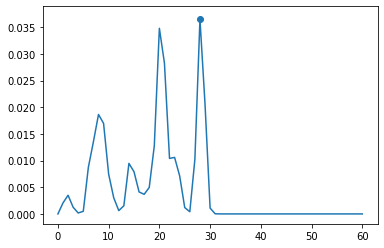

In [61]:
from scipy.fftpack import fft
from scipy.signal import resample
def get_fft_values(y_values, N, f_s):
    f_values = np.linspace(0.0, f_s/2.0, N//2)
    fft_values_ = fft(y_values)
    fft_values = 2.0/N * np.abs(fft_values_[0:N//2])
    return f_values, fft_values


from scipy.signal import welch
def get_psd_values(y_values, N, f_s):
    f_values, psd_values = welch(y_values, fs=f_s)
    return f_values, psd_values


def show_topK_peak(fft_values,top_peak_number=1):  
    '''
    show_topK_peak(fft_values)
    '''
    peak_list = []
    for index,values in enumerate(fft_values):
        if index == 0 or index == len(fft_values) - 1:
            continue
        if fft_values[index] > fft_values[index - 1] and fft_values[index] > fft_values[index + 1]:
            peak_list.append((values,index))
    t_res = sorted(peak_list)[::-1]
#     print(t_res)
#     t_res = sorted(zip(fft_values,range(len(fft_values))))[::-1]
#     print(t_res)
    top_peak_A = [A for A,P in t_res[:top_peak_number]]
    top_peak_P = [P for A,P in t_res[:top_peak_number]]
#     print(top_peak_A)
    plt.plot(range(len(fft_values)),fft_values)
    plt.scatter(top_peak_P,top_peak_A)
    plt.show()
    
    
top_peak_number = 1    
def get_fft_topK_AP(array_with_time,feat_name,K=top_peak_number):
#     print(array_with_time)
    x,t = resample(array_with_time[feat_name], 120, np.array(array_with_time["time_point"]))
    f_values, fft_values = get_fft_values(x, N=120, f_s=5)
    peak_list = []
    for index,values in enumerate(fft_values):
        if index == 0 or index == len(fft_values) - 1:
            continue
        if fft_values[index] > fft_values[index - 1] and fft_values[index] > fft_values[index + 1]:
            peak_list.append((values,index))
    if len(peak_list) < 5:
        cnt = 5 - len(peak_list)
        for i in range(cnt):
            peak_list.append((0,-1))
    t_res = sorted(zip(fft_values,range(len(fft_values))))[::-1]
#     print(t_res)
    top_peak_A = [A for A,P in t_res[:top_peak_number]]
    top_peak_P = [P for A,P in t_res[:top_peak_number]]
    return [top_peak_A + top_peak_P]


top_peak_number = 1  
def get_psd_topK_AP(array_with_time,feat_name,K=top_peak_number):
#     print(array_with_time)
    x,t = resample(array_with_time[feat_name], 120, np.array(array_with_time["time_point"]))
    f_values, fft_values = get_psd_values(x, N=120, f_s=5)
    peak_list = []
    for index,values in enumerate(fft_values):
        if index == 0 or index == len(fft_values) - 1:
            continue
        if fft_values[index] > fft_values[index - 1] and fft_values[index] > fft_values[index + 1]:
            peak_list.append((values,index))
    if len(peak_list) < 5:
        cnt = 5 - len(peak_list)
        for i in range(cnt):
            peak_list.append((0,-1))
    
    t_res = sorted(zip(fft_values,range(len(fft_values))))[::-1]

    top_peak_A = [A for A,P in t_res[:top_peak_number]]
    top_peak_P = [P for A,P in t_res[:top_peak_number]]
     
    '''
    (19) Root mean square of the differences between two successive peaks;
    (20) Standard deviation of the intervals between two successive peaks;
    (21) The number of pairs of successive peaks intervals that differ by more than 50 ms.
    '''
    t_res2 = sorted(peak_list,key=lambda x:x[1])[::-1]
    diff_of_successive_peaks = np.zeros(len(t_res2) - 1)
    intervals_of_successive_peaks = np.zeros(len(t_res2) - 1)
    peak_values = np.array([p for p,i in peak_list])
    for index,i in enumerate(t_res2):
        if index == 0:
            continue
        diff_of_successive_peaks[index-1] = t_res2[index][0] - t_res2[index-1][0]
        intervals_of_successive_peaks[index-1] = t_res2[index][1] - t_res2[index-1][1]
    return [top_peak_A + top_peak_P]

index = 4007
tmp = data[data.fragment_id == index][:120]
x,t = resample(tmp.drop(['fragment_id', 'time_point', 'behavior_id',"time_diff"],
                                    axis=1), 120, np.array(tmp.time_point))
f_values, psd_values = get_psd_values(x[:,2], N=120, f_s=5)
show_topK_peak(psd_values)

In [62]:
oral_item = ["acc_x","acc_y","acc_z","acc_xg","acc_yg","acc_zg","acc","accg"]
top_peak_number = 1
for item in tqdm(oral_item):
    tmp = data[["fragment_id",item,"time_point"]].groupby(["fragment_id"],as_index=False)[item].agg(get_fft_topK_AP,feat_name=item)
    
    for A in range(top_peak_number):
        print(A)
        tmp[item+"_fftA_"+str(A)] = tmp[item].apply(lambda x:x[A])
        df = df.merge(tmp[["fragment_id",item+"_fftA_"+str(A)]],on='fragment_id',how='left')
    for P in range(top_peak_number):
        print(P)
        tmp[item+"_fftP_"+str(P)] = tmp[item].apply(lambda x:x[top_peak_number+P])
        df = df.merge(tmp[["fragment_id",item+"_fftP_"+str(P)]],on='fragment_id',how='left')
    
    tmp = data[["fragment_id",item,"time_point"]].groupby(["fragment_id"],as_index=False)[item].agg(get_psd_topK_AP,feat_name=item)
    for A in range(top_peak_number):
        tmp[item+"_psdA_"+str(A)] = tmp[item].apply(lambda x:x[A])
        df = df.merge(tmp[["fragment_id",item+"_psdA_"+str(A)]],on='fragment_id',how='left')
    for P in range(top_peak_number):
        tmp[item+"_psdP_"+str(P)] = tmp[item].apply(lambda x:x[top_peak_number+P])
        df = df.merge(tmp[["fragment_id",item+"_psdP_"+str(P)]],on='fragment_id',how='left')


  0%|          | 0/8 [00:00<?, ?it/s]

0
0


C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

0
0


C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

0
0


C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

0
0


C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

0
0


C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

0
0


C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

0
0


C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

0
0


C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 120, using nperseg = 120
  .format(nperseg, input_length))
C:\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater 

In [5]:
data_train.head(10)

,fragment_id,time_point,acc_x,acc_y,acc_z,acc_xg,acc_yg,acc_zg,behavior_id
0,0,27,0.3,-0.3,0.1,0.6,4.5,8.8,0
1,0,108,0.1,-0.0,-0.4,0.4,4.7,8.4,0
2,0,198,0.1,0.0,0.3,0.9,4.6,9.0,0
3,0,297,0.1,-0.1,-0.5,0.8,4.7,7.2,0
4,0,388,0.1,0.2,0.6,0.9,4.7,8.9,0
5,0,471,-0.2,0.0,0.2,0.6,4.9,8.6,0
6,0,560,0.0,-0.0,0.1,0.6,4.9,8.6,0
7,0,644,0.0,0.0,-0.7,1.3,5.0,8.3,0
8,0,730,0.4,-0.0,-0.2,1.0,5.1,8.3,0
9,0,814,-0.1,-0.0,-0.2,0.6,5.0,8.1,0


In [15]:
train_df = df[df[label].isna()==False].reset_index(drop=True)
test_df = df[df[label].isna()==True].reset_index(drop=True)

drop_feat = ["istrain"]
used_feat = [f for f in train_df.columns if f not in (['fragment_id', label] + drop_feat)and 'id'not in f]
print(len(used_feat))
print(used_feat)

train_x = train_df[used_feat]
train_y = train_df[label]
test_x = test_df[used_feat]

162
['time_diff_is_outlier', 'time_diff_outlier_counter', 'acc_x_fftA_0', 'acc_x_fftA_1', 'acc_x_fftA_2', 'acc_x_fftA_3', 'acc_x_fftA_4', 'acc_x_fftP_0', 'acc_x_fftP_1', 'acc_x_fftP_2', 'acc_x_fftP_3', 'acc_x_fftP_4', 'acc_x_psdA_0', 'acc_x_psdA_1', 'acc_x_psdA_2', 'acc_x_psdA_3', 'acc_x_psdA_4', 'acc_x_psdP_0', 'acc_x_psdP_1', 'acc_x_psdP_2', 'acc_x_psdP_3', 'acc_x_psdP_4', 'acc_y_fftA_0', 'acc_y_fftA_1', 'acc_y_fftA_2', 'acc_y_fftA_3', 'acc_y_fftA_4', 'acc_y_fftP_0', 'acc_y_fftP_1', 'acc_y_fftP_2', 'acc_y_fftP_3', 'acc_y_fftP_4', 'acc_y_psdA_0', 'acc_y_psdA_1', 'acc_y_psdA_2', 'acc_y_psdA_3', 'acc_y_psdA_4', 'acc_y_psdP_0', 'acc_y_psdP_1', 'acc_y_psdP_2', 'acc_y_psdP_3', 'acc_y_psdP_4', 'acc_z_fftA_0', 'acc_z_fftA_1', 'acc_z_fftA_2', 'acc_z_fftA_3', 'acc_z_fftA_4', 'acc_z_fftP_0', 'acc_z_fftP_1', 'acc_z_fftP_2', 'acc_z_fftP_3', 'acc_z_fftP_4', 'acc_z_psdA_0', 'acc_z_psdA_1', 'acc_z_psdA_2', 'acc_z_psdA_3', 'acc_z_psdA_4', 'acc_z_psdP_0', 'acc_z_psdP_1', 'acc_z_psdP_2', 'acc_z_psdP_3'

In [16]:
scores = []
imp = pd.DataFrame()
imp['feat'] = used_feat

params = {
    'learning_rate': 0.1,
    'metric': 'multi_error',
    'objective': 'multiclass',
    'num_class': 19,
    'feature_fraction': 0.80,
    'bagging_fraction': 0.75,
    'bagging_freq': 2,
    'n_jobs': 4,
    'seed': 2020,
    'max_depth': 10,
    'num_leaves': 64,
    'lambda_l1': 0.5,
    'lambda_l2': 0.5,
}

oof_train = np.zeros((len(train_x), 19))
preds = np.zeros((len(test_x), 19))
folds = 5
seeds = [44]#, 2020, 527, 1527]
for seed in seeds:
    kfold = StratifiedKFold(n_splits=folds, shuffle=True, random_state=seed)
    for fold, (trn_idx, val_idx) in enumerate(kfold.split(train_x, train_y)):
        x_trn, y_trn, x_val, y_val = train_x.iloc[trn_idx], train_y.iloc[trn_idx], train_x.iloc[val_idx], train_y.iloc[val_idx]
        train_set = lgb.Dataset(x_trn, y_trn)
        val_set = lgb.Dataset(x_val, y_val)
        print(str(fold)*10)
        model = lgb.train(params, train_set, num_boost_round=500000,
                          valid_sets=(train_set, val_set), early_stopping_rounds=50,
                          verbose_eval=50)
        oof_train[val_idx] += model.predict(x_val) / len(seeds)
        preds += model.predict(test_x) / folds / len(seeds)
        scores.append(model.best_score['valid_1']['multi_error'])
        
#         print(len(imp))
#         print(len(model.feature_importance(importance_type='gain')))
        
        imp['gain' + str(fold + 1)] = model.feature_importance(importance_type='gain')
        imp['split' + str(fold + 1)] = model.feature_importance(importance_type='split')
        del x_trn, y_trn, x_val, y_val, model, train_set, val_set
        gc.collect()

0000000000
Training until validation scores don't improve for 50 rounds
[50]	training's multi_error: 0.00548603	valid_1's multi_error: 0.364633
[100]	training's multi_error: 0.00102863	valid_1's multi_error: 0.344757
[150]	training's multi_error: 0.000514315	valid_1's multi_error: 0.337217
[200]	training's multi_error: 0.000514315	valid_1's multi_error: 0.335161
[250]	training's multi_error: 0.000342877	valid_1's multi_error: 0.331734
Early stopping, best iteration is:
[245]	training's multi_error: 0.000342877	valid_1's multi_error: 0.331049
1111111111
Training until validation scores don't improve for 50 rounds
[50]	training's multi_error: 0.00565747	valid_1's multi_error: 0.362577
[100]	training's multi_error: 0.000857192	valid_1's multi_error: 0.344757
[150]	training's multi_error: 0.000685753	valid_1's multi_error: 0.340644
[200]	training's multi_error: 0.000514315	valid_1's multi_error: 0.337217
[250]	training's multi_error: 0.000342877	valid_1's multi_error: 0.33379
[300]	trainin

In [20]:
oof_y = np.argmax(oof_train, axis=1)
round(accuracy_score(train_y, oof_y), 5)
score = sum(acc_combo(y_true, y_pred) for y_true, y_pred in zip(train_y, oof_y)) / oof_y.shape[0]
round(score, 5)
sub = pd.read_csv(data_path+'提交结果示例.csv')

sub['behavior_id'] = labels

vc = data_train['behavior_id'].value_counts().sort_index()
sns.barplot(vc.index, vc.values)
plt.show()
vc = sub['behavior_id'].value_counts().sort_index()
sns.barplot(vc.index, vc.values)
plt.show()
# sub.to_csv(data_path+'sub/thre060sub%.5f.csv' % score, index=False)
sub.info()

0.71255

In [18]:
def acc_combo(y, y_pred):
    # 数值ID与行为编码的对应关系
    mapping = {0: 'A_0', 1: 'A_1', 2: 'A_2', 3: 'A_3', 
        4: 'D_4', 5: 'A_5', 6: 'B_1',7: 'B_5', 
        8: 'B_2', 9: 'B_3', 10: 'B_0', 11: 'A_6', 
        12: 'C_1', 13: 'C_3', 14: 'C_0', 15: 'B_6', 
        16: 'C_2', 17: 'C_5', 18: 'C_6'}
    # 将行为ID转为编码
    code_y, code_y_pred = mapping[y], mapping[y_pred]
    if code_y == code_y_pred: #编码完全相同得分1.0
        return 1.0
    elif code_y.split("_")[0] == code_y_pred.split("_")[0]: #编码仅字母部分相同得分1.0/7
        return 1.0/7
    elif code_y.split("_")[1] == code_y_pred.split("_")[1]: #编码仅数字部分相同得分1.0/3
        return 1.0/3
    else:
        return 0.0

In [22]:
len(test_x)

7500

In [23]:
train_x.head()

,time_diff_is_outlier,time_diff_outlier_counter,acc_x_fftA_0,acc_x_fftA_1,acc_x_fftA_2,acc_x_fftA_3,acc_x_fftA_4,acc_x_fftP_0,acc_x_fftP_1,acc_x_fftP_2,...,accg_psdA_0,accg_psdA_1,accg_psdA_2,accg_psdA_3,accg_psdA_4,accg_psdP_0,accg_psdP_1,accg_psdP_2,accg_psdP_3,accg_psdP_4
0,False,0.0,0.095500,0.092020,0.088037,0.071845,0.068201,24,2,13,...,0.165491,0.162688,0.106567,0.102961,0.075742,19,26,15,20,27
1,False,0.0,0.050000,0.047902,0.044440,0.042883,0.040711,0,24,4,...,0.075442,0.069420,0.060733,0.052413,0.047520,26,27,20,12,10
2,False,0.0,0.111380,0.101354,0.095443,0.081610,0.080519,13,12,28,...,0.473793,0.249413,0.227329,0.183130,0.177658,10,11,27,9,25
3,True,1.0,0.088078,0.083340,0.082012,0.077895,0.065502,27,6,11,...,0.262652,0.182615,0.171574,0.159651,0.123607,22,26,21,16,15
4,False,0.0,0.172832,0.169693,0.166202,0.118818,0.114920,18,26,25,...,0.979291,0.928014,0.812292,0.706566,0.678668,9,19,8,18,4


In [24]:
train_x.shape

(7292, 162)

In [25]:
data_train.head()

,fragment_id,time_point,acc_x,acc_y,acc_z,acc_xg,acc_yg,acc_zg,behavior_id
0,0,27,0.3,-0.3,0.1,0.6,4.5,8.8,0
1,0,108,0.1,-0.0,-0.4,0.4,4.7,8.4,0
2,0,198,0.1,0.0,0.3,0.9,4.6,9.0,0
3,0,297,0.1,-0.1,-0.5,0.8,4.7,7.2,0
4,0,388,0.1,0.2,0.6,0.9,4.7,8.9,0


In [64]:
train_df = df[df[label].isna()==False].reset_index(drop=True)
test_df = df[df[label].isna()==True].reset_index(drop=True)

drop_feat = ["istrain"]
used_feat = [f for f in train_df.columns if f not in ([ label] + drop_feat)and 'behavior_id'not in f]
print(len(used_feat))
print(used_feat)

train_x = train_df[used_feat]
train_y = train_df[label]
test_x = test_df[used_feat]

35
['fragment_id', 'time_diff_is_outlier', 'time_diff_outlier_counter', 'acc_x_fftA_0', 'acc_x_fftP_0', 'acc_x_psdA_0', 'acc_x_psdP_0', 'acc_y_fftA_0', 'acc_y_fftP_0', 'acc_y_psdA_0', 'acc_y_psdP_0', 'acc_z_fftA_0', 'acc_z_fftP_0', 'acc_z_psdA_0', 'acc_z_psdP_0', 'acc_xg_fftA_0', 'acc_xg_fftP_0', 'acc_xg_psdA_0', 'acc_xg_psdP_0', 'acc_yg_fftA_0', 'acc_yg_fftP_0', 'acc_yg_psdA_0', 'acc_yg_psdP_0', 'acc_zg_fftA_0', 'acc_zg_fftP_0', 'acc_zg_psdA_0', 'acc_zg_psdP_0', 'acc_fftA_0', 'acc_fftP_0', 'acc_psdA_0', 'acc_psdP_0', 'accg_fftA_0', 'accg_fftP_0', 'accg_psdA_0', 'accg_psdP_0']


In [65]:
train_x.shape

(7292, 35)

In [66]:
train_x.to_csv('train_fly.csv',index=False)
test_x.to_csv('test_fly.csv',index=False)

In [37]:
len(test_x)

7500

In [40]:
print(data_train.shape)
print(data_test.shape)

(425359, 9)
(430182, 8)


In [41]:
data_train1 = data_train.merge(train_x,how='left',on='fragment_id')
data_test1 = data_test.merge(test_x,how='left',on='fragment_id')

In [43]:
print(data_train1.shape)
print(data_test1.shape)

(425359, 171)
(430182, 170)


In [45]:
train_fly = pd.read_csv('train_fly.csv')

In [47]:
train_fly.head()

,fragment_id,time_diff_is_outlier,time_diff_outlier_counter,acc_x_fftA_0,acc_x_fftA_1,acc_x_fftA_2,acc_x_fftA_3,acc_x_fftA_4,acc_x_fftP_0,acc_x_fftP_1,...,accg_psdA_0,accg_psdA_1,accg_psdA_2,accg_psdA_3,accg_psdA_4,accg_psdP_0,accg_psdP_1,accg_psdP_2,accg_psdP_3,accg_psdP_4
0,0,False,0.0,0.095500,0.092020,0.088037,0.071845,0.068201,24,2,...,0.165491,0.162688,0.106567,0.102961,0.075742,19,26,15,20,27
1,1,False,0.0,0.050000,0.047902,0.044440,0.042883,0.040711,0,24,...,0.075442,0.069420,0.060733,0.052413,0.047520,26,27,20,12,10
2,2,False,0.0,0.111380,0.101354,0.095443,0.081610,0.080519,13,12,...,0.473793,0.249413,0.227329,0.183130,0.177658,10,11,27,9,25
3,3,True,1.0,0.088078,0.083340,0.082012,0.077895,0.065502,27,6,...,0.262652,0.182615,0.171574,0.159651,0.123607,22,26,21,16,15
4,4,False,0.0,0.172832,0.169693,0.166202,0.118818,0.114920,18,26,...,0.979291,0.928014,0.812292,0.706566,0.678668,9,19,8,18,4


In [53]:
df.shape

(14792, 484)